### "Enhancing Road Safety: A Comprehensive Analysis of US Traffic Accidents"

The primary goal of the project is to analyze and generate insights on the traffic accidents that took place in USA
from Feb. 2016 to Mar. 2023. The first part of the analysis will examine countrywide accident events. In second part,the data will be filtered for a US city where most number of accidents have occurered, then the city data will be analyzed to produce valuable insights about accients in that city.

Throughout the analysis, the following questions will be answered:
    
Countrywide Analysis:

- What are the U.S. States with the Highest Number of Accidents.
- What are the U.S. Cities with the Highest Number of Accidents.
- No of Road Accidents for different Timezones in US.
- What is the trend of accidents by year from 2016 to 2023?
- What is the trend of accidents per months by year from 2016 to 2023?
- What is the no of/avg accidents monthly(2016-2023)?
- Which days of the week have a higher probability of accidents?
- What is the distribution of accidents throughout the day, and are there specific hours when accidents are more likely to occur?
- Breakdown of Accident Severity(Percentagewise) & Trend of Severity Level by Year.
- What are the most frequent words in the descriptions of severity 4 as well 2 accidents?
- What are the top weather conditions that contribute to the accidents?
- Is there any effect of Temperature on accidents?
- Is there any effect of Humidity on accidents?

Miami City Analysis:

- Timeseries Analysis of the accidents in Miami city, analysis by year, month, day of the week, and hour of the day.
- Which Miami streets are the most vulnerable to accidents?
- Which streets cause higher delay time & different level accident severities?
- Present the distribution of Accidents on the Miami City map.

(AutoGulon) Model Implementation to Predict different level of Severity.
- Is this a supervised prediction problem? - Yes
- What is the target variable?- Severity

In [16]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter
import matplotlib.ticker as ticker
import matplotlib.patches as mpatches
import matplotlib.patheffects as PathEffects
%matplotlib inline

import seaborn as sns
import calendar
import plotly as pt
from plotly import graph_objs as go
import plotly.express as px
import plotly.figure_factory as ff
from pylab import *

import plotly.graph_objects as go
from nltk.corpus import stopwords

import geopandas as gpd
import geoplot
from geopy.geocoders import Nominatim

import warnings
warnings.filterwarnings('ignore')

pd.set_option('display.max_columns', 50)


In [17]:
df = pd.read_csv("USA.csv")

In [18]:
df.head(1)

,ID,Source,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Description,Street,City,County,State,Zipcode,Country,Timezone,Airport_Code,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,A-2047758,Source2,2,2019-06-12 10:10:56,2019-06-12 10:55:58,30.641211,-91.153481,NaN,NaN,0.0,Accident on LA-19 Baker-Zachary Hwy at Lower Z...,Highway 19,Zachary,East Baton Rouge,LA,70791-4610,US,US/Central,KBTR,2019-06-12 09:53:00,77.0,77.0,62.0,29.92,10.0,NW,5.0,0.0,Fair,False,False,False,False,False,False,False,False,False,False,False,True,False,Day,Day,Day,Day


In [19]:
print("Size of our Dataset:", df.shape)

Size of our Dataset: (500000, 46)


In [21]:
df.describe()

,Severity,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Speed(mph),Precipitation(in)
count,500000.000000,500000.000000,500000.000000,279623.000000,279623.000000,500000.000000,489534.000000,370983.000000,488870.000000,491072.000000,488709.000000,463013.000000,357384.000000
mean,2.212748,36.206421,-94.736583,36.273192,-95.776553,0.564317,61.646254,58.229028,64.834921,29.536621,9.091540,7.681347,0.008289
std,0.486661,5.071411,17.405761,5.265333,18.120211,1.774872,19.000133,22.352246,22.826158,1.008666,2.708083,5.431361,0.101865
min,1.000000,24.562117,-124.497420,24.570110,-124.497419,0.000000,-77.800000,-53.200000,1.000000,0.120000,0.000000,0.000000,0.000000
25%,2.000000,33.416823,-117.233047,33.474773,-117.778324,0.000000,49.000000,43.000000,48.000000,29.370000,10.000000,4.600000,0.000000
50%,2.000000,35.832147,-87.794365,36.192669,-88.039013,0.029000,64.000000,62.000000,67.000000,29.860000,10.000000,7.000000,0.000000
75%,2.000000,40.082443,-80.359601,40.181341,-80.252449,0.465000,76.000000,75.000000,84.000000,30.030000,10.000000,10.400000,0.000000
max,4.000000,48.999569,-67.484130,48.998901,-67.484130,193.479996,207.000000,207.000000,100.000000,38.440000,130.000000,822.800000,10.130000



1. Severity Distribution:
Most accidents have a severity level of 2, with a mean severity of approximately 2.21.

2. Weather Conditions:
Mean temperature is around 61.65°F, and wind chill varies with a mean of 58.23°F.

3. Distance and Visibility:
Mean accident distance is 0.56 miles, and 75% of incidents have visibility levels of 10 miles or mor, suggests that a majority of the accidents occurred in conditions where visibility was relatively good.

4. Weather Impact:
Precipitation is generally low (mean of 0.008 inches), and wind speed has a mean of 7.68 mph (with a potential outlier at 822.8 mph).


## Exploring Accidents(EDA): A Deep Dive into Data Insights


#### Accident Overview using Folium

In [23]:
import folium
from folium.plugins import FastMarkerCluster

subset_df = df.copy()  

# Create a map centered at a specific location
map = folium.Map(location=[37.0902, -95.7129], zoom_start=4.4)

# Extract latitudes and longitudes using iterrows()
latitudes = []
longitudes = []
for index, row in subset_df.iterrows():
    latitudes.append(row['Start_Lat'])
    longitudes.append(row['Start_Lng'])

# Create a FastMarkerCluster and add it to the map
FastMarkerCluster(data=list(zip(latitudes, longitudes))).add_to(map)

# Display the map

map

This diagram shows the western and eastern and southeast coasts, as well as regions close to the five lakes, experience a significantly higher number of accidents.

In [8]:
state_counts = df["State"].value_counts()

# convert the states series into a DataFrame
states = pd.DataFrame(state_counts).reset_index()

# rename the columns
states.rename(columns={'State': 'state_code', 'count': 'cases'}, inplace=True)

# sort the DataFrame by cases (the no. of accidents)
states = states.sort_values(by='cases', ascending=False)

# print the sorted DataFrame
#states.head()

In [9]:
us_states = {
    'AL': 'Alabama', 'AK': 'Alaska', 'AZ': 'Arizona', 'AR': 'Arkansas', 'CA': 'California',
    'CO': 'Colorado', 'CT': 'Connecticut', 'DE': 'Delaware', 'FL': 'Florida', 'GA': 'Georgia',
    'HI': 'Hawaii', 'ID': 'Idaho', 'IL': 'Illinois', 'IN': 'Indiana', 'IA': 'Iowa', 'KS': 'Kansas',
    'KY': 'Kentucky', 'LA': 'Louisiana', 'ME': 'Maine', 'MD': 'Maryland', 'MA': 'Massachusetts',
    'MI': 'Michigan', 'MN': 'Minnesota', 'MS': 'Mississippi', 'MO': 'Missouri', 'MT': 'Montana',
    'NE': 'Nebraska', 'NV': 'Nevada', 'NH': 'New Hampshire', 'NJ': 'New Jersey', 'NM': 'New Mexico',
    'NY': 'New York', 'NC': 'North Carolina', 'ND': 'North Dakota', 'OH': 'Ohio', 'OK': 'Oklahoma',
    'OR': 'Oregon', 'PA': 'Pennsylvania', 'RI': 'Rhode Island', 'SC': 'South Carolina',
    'SD': 'South Dakota', 'TN': 'Tennessee', 'TX': 'Texas', 'UT': 'Utah', 'VT': 'Vermont',
    'VA': 'Virginia', 'WA': 'Washington', 'WV': 'West Virginia', 'WI': 'Wisconsin', 'WY': 'Wyoming'
}

# Add a new column 'State_Name' based on 'State_Code'
states['state'] = states['state_code'].map(us_states)

# Display the updated DataFrame
states.head()

,state_code,cases,state
0,CA,113274,California
1,FL,56710,Florida
2,TX,37355,Texas
3,SC,24737,South Carolina
4,NY,22594,New York


### States with the Highest Number of Accidents

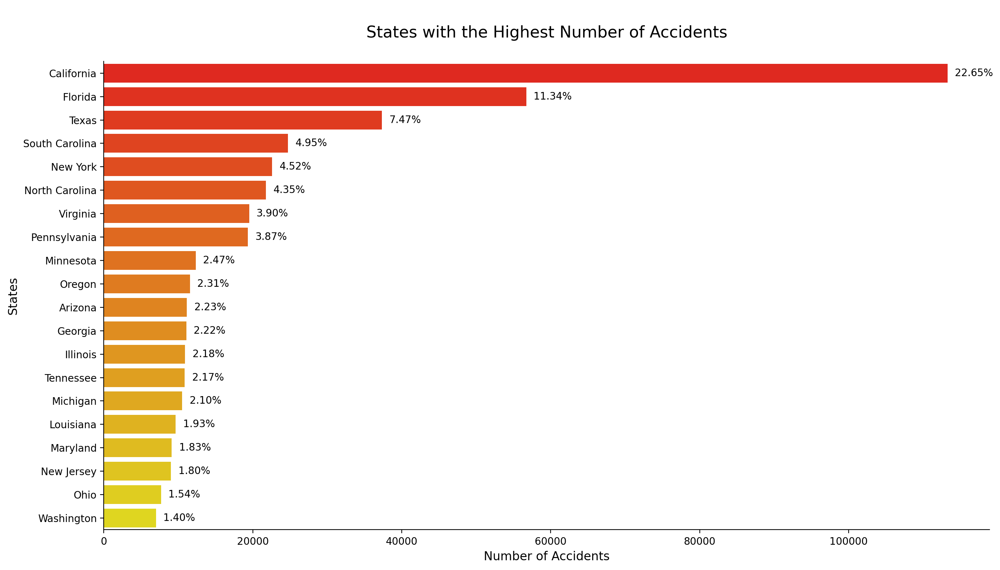

In [10]:
from matplotlib.ticker import FuncFormatter

fig, ax = plt.subplots(figsize=(14, 8), dpi=200)

# Assuming 'states' DataFrame contains columns 'state' and 'cases' with accident data
top_10 = states[:20]

# Create the horizontal bar plot
sns.barplot(x='cases', y='state', data=top_10, palette='autumn', ax=ax)

plt.title("\nStates with the Highest Number of Accidents\n", fontsize=16, color='black')
plt.xlabel("Number of Accidents", fontsize=12, color='black')
plt.ylabel("States", fontsize=12, color='black')

# Display percentage labels at the end of each bar
total_accidents = df.shape[0]
for p in ax.patches:
    width = p.get_width()
    ax.text(width + 1000, p.get_y() + p.get_height() / 2,
            f'{width / total_accidents * 100:.2f}%',
            va='center', fontsize=10, color='black')

# Increase the font size of the axis tick labels
ax.tick_params(axis='both', labelsize=10)

# Format X-axis tick labels to display whole numbers
def format_func(value, _):
    return f'{value:.0f}'
ax.xaxis.set_major_formatter(FuncFormatter(format_func))

# Customize spine colors
for spine in ['top', 'right']:
    ax.spines[spine].set_visible(False)

plt.tight_layout()
plt.show()


### What are the cities with most number of accidents?

In [11]:
cities = pd.DataFrame(df["City"].value_counts()).reset_index().sort_values(by='count',ascending=False)
cities = cities.rename(columns={'City':'city','count':'cases'})

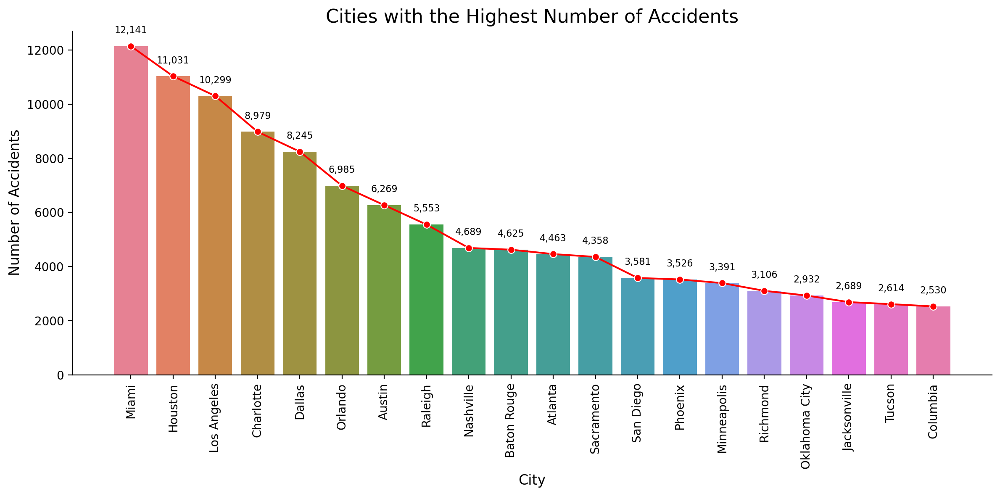

In [12]:
# Set the figure size and style
plt.figure(figsize=(12, 6), dpi=200)

# Create bar plot for top 10 cities with most accidents
top_cities = cities[:20]
sns.barplot(x='city', y='cases', data=top_cities, palette='husl')

# Add text labels slightly above the bars with comma-separated values
for i, val in enumerate(top_cities['cases'].values):
    formatted_val = f'{val:,}'  # Format with commas
    plt.text(i, val + 400, f'{formatted_val}', horizontalalignment='center', verticalalignment='bottom', fontdict={'fontweight': 500, 'size': 8})

# Create line plot for the same data (overlaying on the bar plot)
sns.lineplot(x='city', y='cases', data=top_cities, marker='o', color='red')

# Set title and axis labels
plt.title("Cities with the Highest Number of Accidents", fontsize=16, color='black')
plt.ylabel("Number of Accidents", fontsize=12, color='black')
plt.xlabel("City", fontsize=12, color='black')
plt.xticks(rotation=90)  # Rotating labels by 180 degrees
plt.rc('xtick', labelsize=12, color='black')
plt.rc('ytick', labelsize=12, color='black')
plt.gca().yaxis.set_major_formatter(plt.FuncFormatter(lambda value, _: f'{value:.0f}'))

# Adjust spines and layout
for spine in ['top', 'right']:
    plt.gca().spines[spine].set_color('white')
    plt.gca().spines[spine].set_linewidth(1.5)
plt.tight_layout()

# Show the plot
plt.show()


### Timezone Analysis

In [13]:
from shapely.geometry import Point, Polygon

geometry = [Point(xy) for xy in zip(df['Start_Lng'], df['Start_Lat'])]
geo_df = gpd.GeoDataFrame(df, geometry=geometry)
geo_df["Start_Time"] = pd.to_datetime(df["Start_Time"], format="mixed", errors='coerce', dayfirst=True)
geo_df['year'] = geo_df.Start_Time.dt.year
states = gpd.read_file('map')

In [14]:
timezone_df = pd.DataFrame(df['Timezone'].value_counts()).reset_index().rename(columns={'index':'Timezone', 'count':'Cases'})

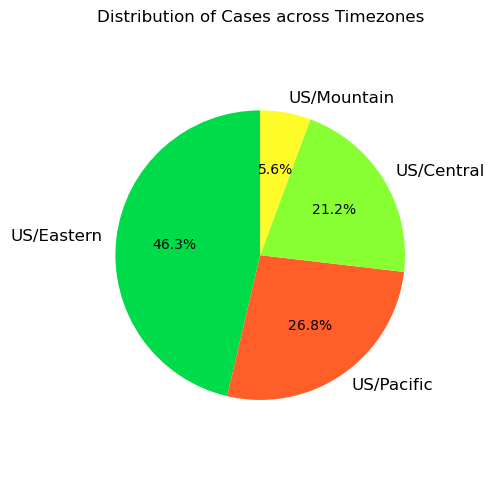

In [25]:
# Sample data from timezone_df
timezones = timezone_df['Timezone']
cases = timezone_df['Cases']

# Define colors
colors = ['#00db49', '#ff5e29', '#88ff33', '#fffb29']

# Create a pie chart
fig, ax = plt.subplots(figsize=(5, 5), dpi=100)
ax.pie(cases, labels=timezones, autopct='%1.1f%%', startangle=90, colors=colors)

# Add a title
plt.title('Distribution of Cases across Timezones', size=12)

# Center the pie chart
ax.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle

# Show the plot
plt.tight_layout()
plt.show()


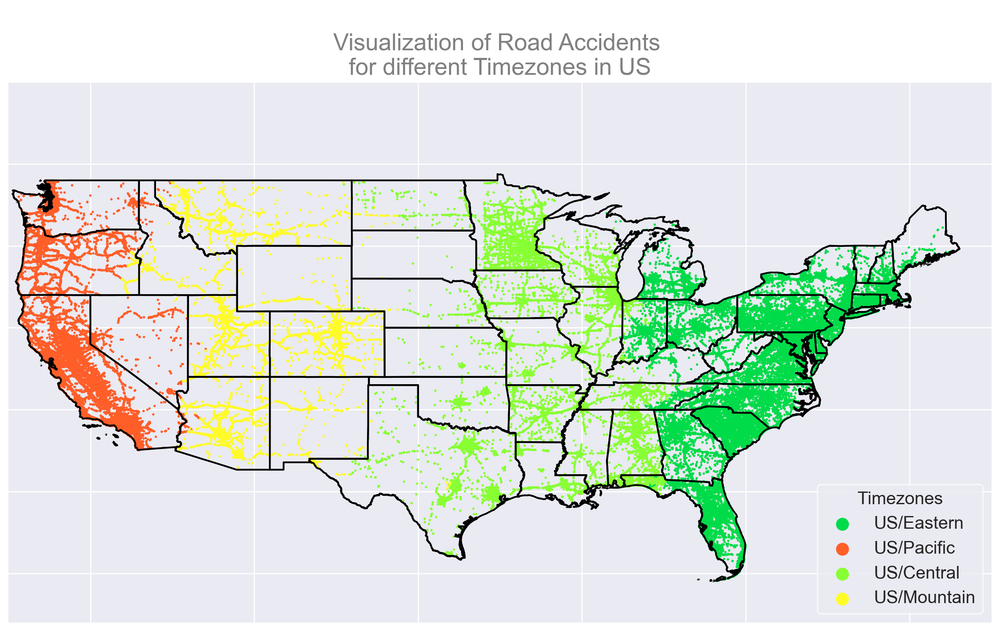

In [56]:
fig, ax = plt.subplots(figsize=(15,15), dpi=200)
ax.set_xlim([-125,-65])
ax.set_ylim([22,55])
states.boundary.plot(ax=ax, color='black');

colors = ['#00db49', '#ff5e29', '#88ff33', '#fffb29']
#4132
count = 0
for i in list(timezone_df.Timezone):
    geo_df[geo_df['Timezone'] == i].plot(ax=ax, markersize=1, color=colors[count], marker='o', label=i);
    count += 1

plt.legend(markerscale=10., prop={'size': 15}, edgecolor='white', title="Timezones", title_fontsize=15, loc='lower right');

for i in ['bottom', 'top', 'left', 'right']:
    side = ax.spines[i]
    side.set_visible(False)
    
plt.tick_params(top=False, bottom=False, left=False, right=False,
                labelleft=False, labelbottom=False)

plt.title('\nVisualization of Road Accidents \nfor different Timezones in US', size=20, color='grey');

### Time Series Analysis

In [27]:
# convert the Start_Time and End_Time attributes to datetime
df["Start_Time"] = pd.to_datetime(df["Start_Time"], format="mixed", errors='coerce', dayfirst=True)
df["End_Time"] = pd.to_datetime(df["End_Time"], format="mixed", errors='coerce', dayfirst=True)

# Extract year, month, weekday and day
df["Year"] = df["Start_Time"].dt.year
df["Month"] = df["Start_Time"].dt.month
df["Weekday"] = df["Start_Time"].dt.weekday
df["Day"] = df["Start_Time"].dt.day
df["Hour"] = df["Start_Time"].dt.hour

### How do the no.of accidents change over year?

In [28]:
year_df = pd.DataFrame(df['Year'].value_counts()).reset_index().sort_values(by='Year', ascending=True)
year = year_df.rename(columns={'Year':'year','count':'cases'})

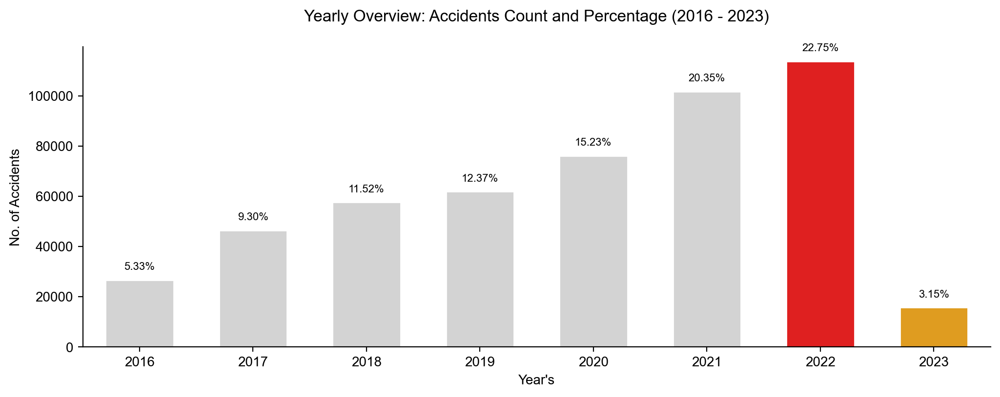

In [29]:
from matplotlib.ticker import FuncFormatter

# Create figure and axes
fig, ax = plt.subplots(figsize=(12, 4), dpi=200)
sns.set_style('ticks')  # Choose style: white, dark, whitegrid, darkgrid, ticks 

# Determine colors based on conditions
colors = [
    'red' if val == max(year['cases']) else 'orange' if val == min(year['cases']) else 'lightgrey' 
    for val in year['cases']
]

# Create bar plot with adjusted width
sns.barplot(x=year.year, y=year.cases, palette=colors, ax=ax, width=0.6)  # Adjust width here

# Remove top and right spines
for spine in ['top', 'right']:
    ax.spines[spine].set_visible(False)

# Set labels and title
ax.set_xlabel("Year's", fontdict={'fontsize': 10, 'color': 'black'})
ax.set_ylabel("No. of Accidents", fontdict={'fontsize': 10, 'color': 'black'})
ax.set_title('Yearly Overview: Accidents Count and Percentage (2016 - 2023)\n', 
             fontdict={'fontsize': 12, 'color': 'black'})

# Customize Y-axis tick labels to display as whole numbers
def format_func(value, _):
    return f'{value:.0f}'  # Format as whole numbers

ax.yaxis.set_major_formatter(FuncFormatter(format_func))

total_accidents = df.shape[0]
# Add text labels showing percentages above each bar
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x() + p.get_width() / 2, height + 4000,
            '{:.2f}%'.format(height / total_accidents * 100),
            ha="center", fontsize=8, color='black')

# Remove top and right spines again (redundancy check)
for spine in ['top', 'right']:
    ax.spines[spine].set_visible(False)

# Set x-axis and y-axis tick label font sizes to 10
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

plt.show()


In [30]:
year_max_acc=df.Start_Time.dt.year.value_counts()
year_max_acc

Start_Time
2022    113734
2021    101740
2020     76155
2019     61852
2018     57578
2017     46514
2016     26663
2023     15764
Name: count, dtype: int64

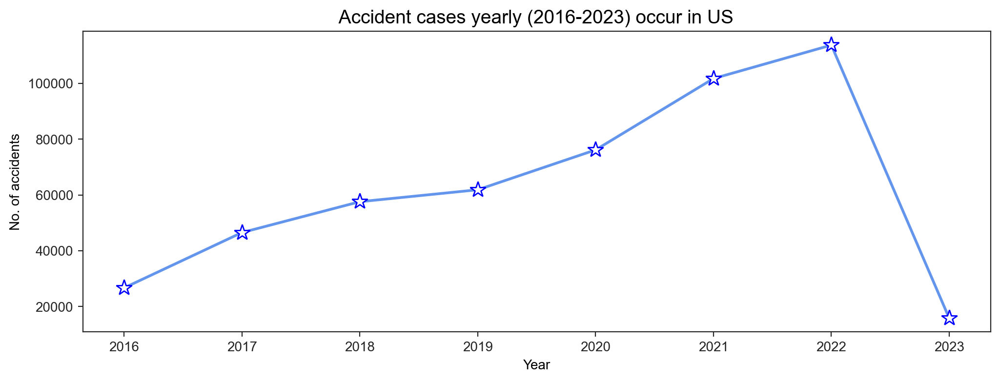

In [31]:
plt.figure(figsize=(12,4),dpi=200)
sns.lineplot(data=year_max_acc,linewidth=2,linestyle='solid', color='CornFlowerBlue',marker='*', markersize=12,markerfacecolor='w',markeredgecolor='b',markeredgewidth='1')
plt.title(" Accident cases yearly (2016-2023) occur in US ",fontdict={'fontsize': 14, 'color': 'black'})
plt.xlabel('Year', fontdict={'fontsize': 10, 'color': 'black'})
plt.ylabel('No. of accidents', fontdict={'fontsize': 10, 'color': 'black'})
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.show()

### Accidents per Month over Years

### What are the average monthly accidents (2016-2023)

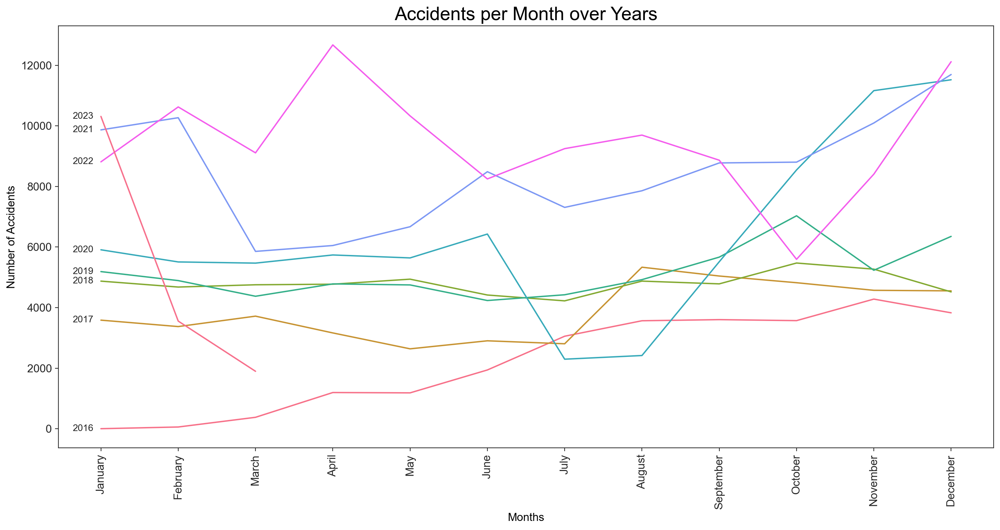

In [32]:
def plot_accidents_per_month(df):
    """
    Plots the number of accidents per month over the years.

    Parameters:
    df (DataFrame): DataFrame containing accident data with 'Start_Time' column.

    Returns:
    None
    """
    # Error handling for converting Start_Time to datetime
    try:
        df["Start_Time"] = pd.to_datetime(df["Start_Time"], dayfirst=True)
    except KeyError as e:
        print(f"Column 'Start_Time' not found: {e}")
        return

    # Extract year and month
    df["Year"] = df["Start_Time"].dt.year
    df["Month"] = df["Start_Time"].dt.month
    df["Day"] = df["Start_Time"].dt.day

    # Group by year and month to get the count of accidents
    year_month_count = df.groupby(['Year', 'Month']).size().reset_index(name='Accident_Count')

    # Sort unique years in ascending order
    unique_years = sorted(df['Year'].unique())

    # Plotting the graph
    plt.figure(figsize=(15, 8),dpi=200)

    sns.lineplot(data=year_month_count, x='Month', y='Accident_Count', hue='Year', palette='husl', hue_order=unique_years, legend=False)

    plt.title('Accidents per Month over Years', fontsize=20, color='black')
    plt.xlabel('Months', fontsize=12, color='black')
    plt.ylabel('Number of Accidents', fontsize=12, color='black')

    plt.xticks(ticks=range(1, 13), labels=[
        'January', 'February', 'March', 'April', 'May', 'June',
        'July', 'August', 'September', 'October', 'November', 'December'
    ], rotation=90)  # Rotating labels by 90 degrees

    # Adding year names at the beginning of each year's line
    for year in unique_years:
        year_data = year_month_count[year_month_count['Year'] == year]
        first_month_data = year_data.iloc[0]  # Taking the first month's data for each year
        x = first_month_data['Month']
        y = first_month_data['Accident_Count']
        plt.text(x - 0.1, y, str(year), va='center', ha='right')  # Adjusting the x-position for the year label

    plt.tight_layout()
    plt.show()

# Assuming df contains the accident data with the necessary columns
# Call the function to plot accidents per month over years
plot_accidents_per_month(df)


In [33]:
month_df = pd.DataFrame(df.Start_Time.dt.month.value_counts()).reset_index()
month = month_df.rename(columns={'Start_Time':'month#','count':'cases'}).sort_values(by='month#', ascending=True)

# adding month name as a column
month_map = {1:'January' , 2:'February' , 3:'March' , 4:'April' , 5:'May' , 6:'June', 7:'July' , 8:'August', 9:'September',10:'October' , 11:'November' , 12:'December'}
month['month_name'] = month['month#'].map(month_map)

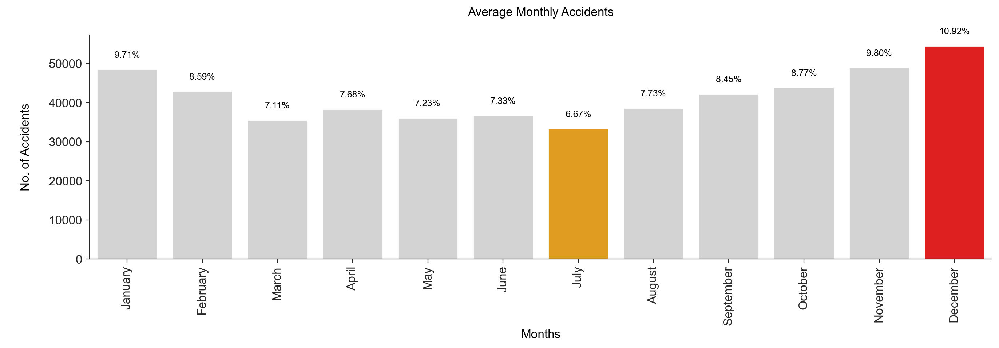

In [34]:
from matplotlib.ticker import FuncFormatter

# Your existing code

fig, ax = plt.subplots(figsize=(16, 4), dpi=200)
sns.set_style('ticks')

# Determine the colors (as before)
colors = ['red' if val == max(month['cases']) else 'orange' if val == min(month['cases']) else 'lightgrey' for val in month['cases']]

sns.barplot(x=month.month_name, y=month.cases, palette=colors, ax=ax)

ax.set_title('Average Monthly Accidents\n', fontdict={'fontsize': 12, 'color': 'black'})
ax.set_ylabel("\nNo. of Accidents\n", fontsize=12, color='black')
ax.set_xlabel('Months', fontsize=12, color='black')

# Customize Y-axis tick labels to show real numbers
def format_func(value, _):
    return f'{value:.0f}'  # Format as whole numbers

ax.yaxis.set_major_formatter(FuncFormatter(format_func))

for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x() + p.get_width() / 2,
            height + 3000,
            '{:.2f}%'.format(height / total_accidents * 100),
            ha="center",
            fontsize=9, color='black')

for i in ['top', 'right']:
    side = ax.spines[i]
    side.set_visible(False)

# Rotate x-axis tick labels by 90 degrees
plt.xticks(rotation=90)

plt.show()


### What days of the week have higher probability of accidents?

In [35]:
dow = pd.DataFrame(df['Start_Time'].dt.dayofweek.value_counts()).reset_index()
dow = dow.rename(columns={'Start_Time':'day_of_week', 'count':'cases'}).sort_values(by='day_of_week')
day_map = {0:'Monday' , 1:'Tuesday' , 2:'Wednesday' , 3:"Thursday" , 4:'Friday' , 5:"Saturday" , 6:'Sunday'}   
dow['weekday'] = dow['day_of_week'].map(day_map)

In [36]:
import plotly.express as px

# Calculate percentage of accidents for each day of the week
total = dow['cases'].sum()
dow['percentage'] = (dow['cases'] / total) * 100

# Define a custom color palette
custom_colors = px.colors.qualitative.Plotly  # You can replace this with any other color palette from Plotly

# Plotting an interactive donut pie chart with custom colors and size information
fig = px.pie(
    dow,
    values='cases',
    names='weekday',
    hole=0.5,
    color='weekday',
    color_discrete_sequence=custom_colors,
    title='Percentage of Accidents by Day of the Week',
    custom_data=['percentage'],  # Use custom_data to provide additional data
)

# Customize layout for a smaller figure size
fig.update_layout(
    font=dict(size=10),
    width=500,  # Set the width of the figure
    height=400,  # Set the height of the figure
)

# Update hover information to include the percentage
fig.update_traces(
    hovertemplate='<b>%{label}</b><br>Accident Cases: %{value}<br>Percentage: %{customdata[0]:.2f}%'
)

fig.show()


### What is the distribution of accidents throughout the day, and are there specific hours when accidents are more likely to occur?

In [67]:
hour_of_day = pd.DataFrame(df['Hour'].value_counts()).reset_index().rename(columns={'Hour':'hour','count':'cases'})
hour_of_day.sort_values(by='hour', inplace=True)

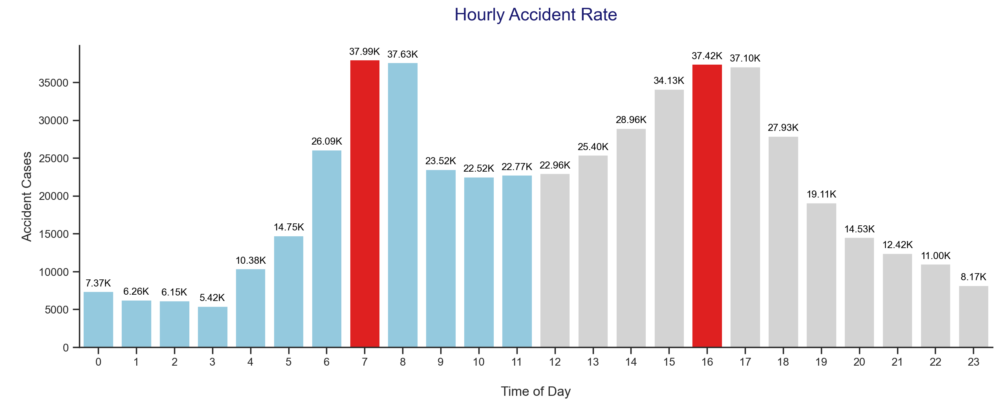

In [68]:
# Set up the figure and axis
fig, ax = plt.subplots(figsize=(15, 5), dpi=200)
sns.set_style('ticks')

# Determine colors for different time ranges based on accident cases
colors = []
for x in hour_of_day['cases']:
    if int(hour_of_day[hour_of_day['cases'] == x]['hour']) <= 11:
        if x == max(list(hour_of_day['cases'])[:12]):
            colors.append('red')  # Highlight the maximum for first half of the day
        else:
            colors.append('skyblue')  # Other cases in the first half of the day
    else:
        if x == max(list(hour_of_day['cases'])[12:]):
            colors.append('red')  # Highlight the maximum for the second half of the day
        else:
            colors.append('lightgrey')  # Other cases in the second half of the day

# Create a bar plot of 'hourly_accident_rate'
sns.barplot(x=hour_of_day.hour, y=hour_of_day.cases, palette=colors)

# Display accident cases on the bars in thousands with 2 decimal points
for i, val in enumerate(hour_of_day['cases']):
    val_in_k = val / 1000  # Convert to thousands
    if int(hour_of_day.loc[i, 'hour']) <= 11:
        ax.text(i, val + 700, f'{val_in_k:.2f}K', ha='center', color='black', size=9)
    else:
        ax.text(i, val + 700, f'{val_in_k:.2f}K', ha='center', color='black', size=9)

# Set plot title and axis labels
plt.title('Hourly Accident Rate\n', size=16, color='MidnightBlue')
plt.ylabel('\nAccident Cases', fontsize=12)
plt.xlabel('\nTime of Day', fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# Remove top and right spines
for side in ['top', 'right']:
    ax.spines[side].set_visible(False)

# Show the plot
plt.show()


The early morning hours (around 7 AM) and the evening hours (around 4 PM) are associated with the highest number of accidents, with each time experienced more than 50,000 accidents on average.

## Accident Severity Analysis

### What are the most frequent words in the descriptions of severity 4 accidents?

### We will find and list the most common words in the "description" column of accidents that have a severity level of 4 using some stopwords from the english language.

In [69]:
description_s4 = df[df["Severity"] == 4]["Description"] # filter the data

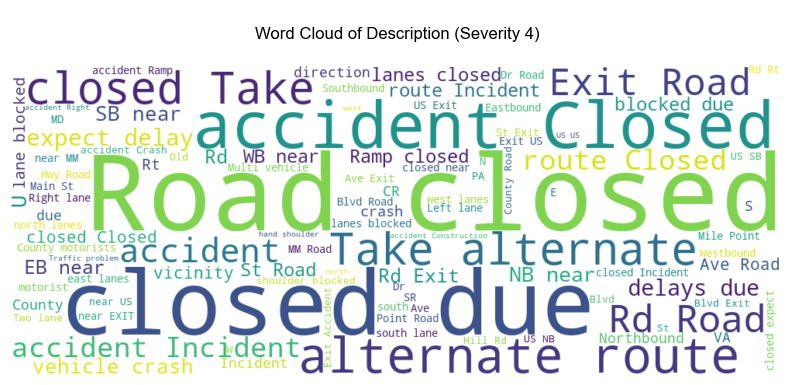

In [70]:
from wordcloud import WordCloud

# Assuming description_s4 contains the filtered descriptions
text = ' '.join(description_s4.astype(str).tolist())

# Generate the word cloud
wordcloud = WordCloud(width=1000, height=400, max_words=100, background_color='white').generate(text)

# Display the word cloud using matplotlib
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('\nWord Cloud of Description (Severity 4)\n', size=12, color='black')
plt.show()


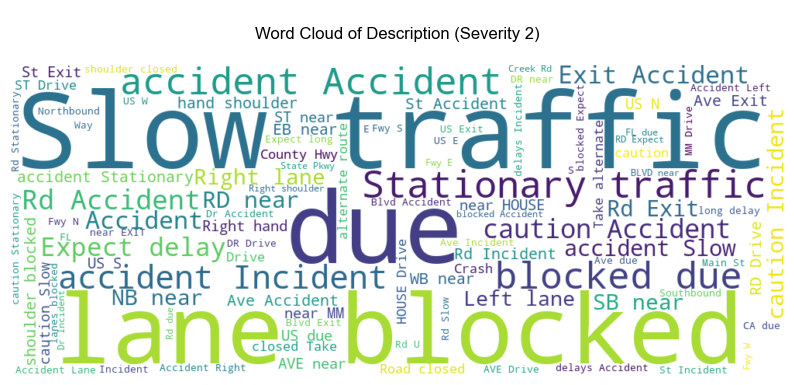

In [74]:
description_s2 = df[df["Severity"]==2]["Description"] # filter the data

# Assuming description_s2 contains the filtered descriptions
text = ' '.join(description_s2.astype(str).tolist())

# Generate the word cloud
wordcloud = WordCloud(width=1000, height=400, max_words=100, background_color='white').generate(text)

# Display the word cloud using matplotlib
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('\nWord Cloud of Description (Severity 2)\n', size=12, color='black')
plt.show()

We can see that the most used word in the description is closed. Subsequent words are accident, due and road.



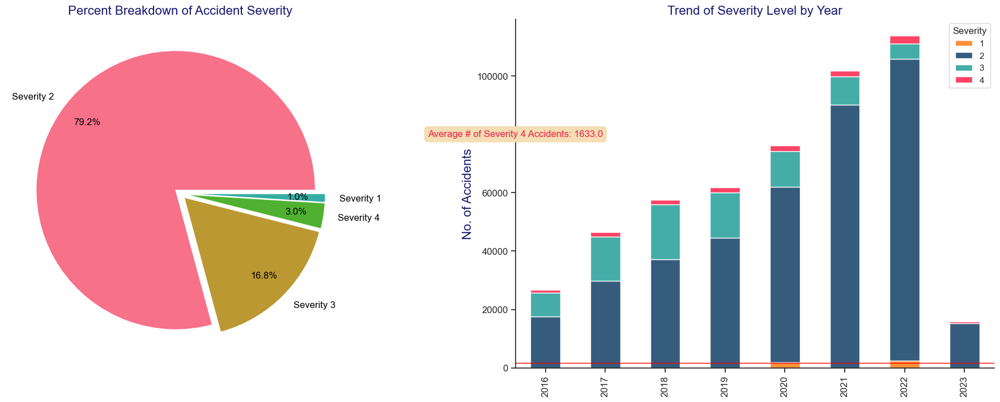

In [78]:
# Assuming s4_by_yr calculation has been done on the dataset
s4_by_yr = df[df['Severity'] == 4][['Severity', 'Year']].groupby('Year').agg({'Severity': 'count'}).mean().round(0)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 8))

# Calculate the percentage of each severity level
severity = df['Severity'].value_counts(normalize=True).round(2) * 100

# Pie chart for severity breakdown
severity.plot.pie(autopct='%1.1f%%', ax=ax1, colors=sns.color_palette(palette='husl'),
                  pctdistance=0.8, explode=[.04, .04, .04, .04],
                  textprops={'fontsize': 12, 'color': 'black'},
                  labels=['Severity 2', 'Severity 3', 'Severity 4', 'Severity 1'])

ax1.set_title("Percent Breakdown of Accident Severity", fontdict={'fontsize': 16, 'color': 'MidnightBlue'})
ax1.set_ylabel(None)

# Assigning distinct colors for severity levels in the bar plot
severity_colors = ['#FC913A', '#355C7D', '#45ADA8', '#FE4365']

# Bar plot for trend of severity level by year with distinct colors
severity_year = df.groupby(['Year', 'Severity']).size().unstack()
severity_year.plot(kind='bar', stacked=True, ax=ax2, color=severity_colors, edgecolor='white')

# Average Severity 4 accidents line and annotation
ax2.axhline(s4_by_yr[0], color='red', linewidth=1)
ax2.annotate(f"Average # of Severity 4 Accidents: {s4_by_yr[0]}",
             va='center', ha='center',
             color='#EC2049',
             bbox=dict(boxstyle='round', pad=0.4, facecolor='Wheat', linewidth=0), xy=(-0.5, 80000))

ax2.set_title("Trend of Severity Level by Year", fontdict={'fontsize': 16, 'color': 'MidnightBlue'})
ax2.set_ylabel("\nNo. of Accidents", fontdict={'fontsize': 16, 'color': 'MidnightBlue'})
ax2.set_xlabel(None)

# Remove spines from the top and right sides of the bar plot
for i in ['top', 'right']:
    side = ax2.spines[i]
    side.set_visible(False)

plt.show()


The charts above illustrate a significant trend: approximately 80% of accidents lead to Severity 02 injuries, it's increasing magnitude each year. Despite constituting only 20% of total accidents, Severity 3 and 4 injuries remain a serious concern due to their proximity to fatal outcomes, emphasizing the need for continued safety measures.

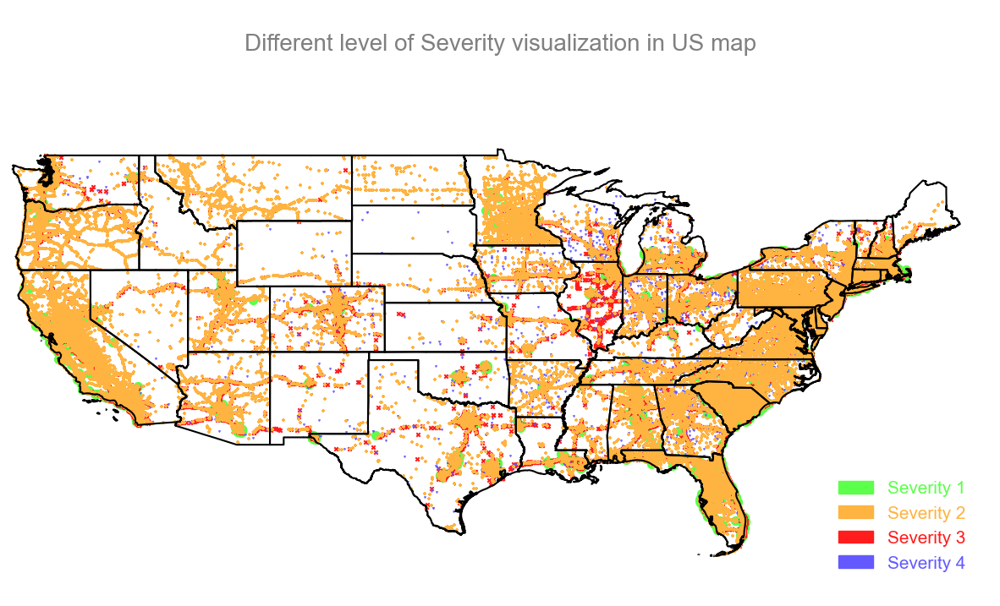

In [79]:
severity_df = pd.DataFrame(df['Severity'].value_counts()).rename(columns={'index':'Severity', 'count':'Cases'})

fig, ax = plt.subplots(figsize=(15,15))
ax.set_xlim([-125,-65])
ax.set_ylim([22,55])
states.boundary.plot(ax=ax, color='black');

geo_df[geo_df['Severity'] == 1].plot(ax=ax, markersize=50, color='#5cff4a', marker='o', label='Severity 1');
geo_df[geo_df['Severity'] == 3].plot(ax=ax, markersize=10, color='#ff1c1c', marker='x', label='Severity 3');
geo_df[geo_df['Severity'] == 4].plot(ax=ax, markersize=1, color='#6459ff', marker='v', label='Severity 4');
geo_df[geo_df['Severity'] == 2].plot(ax=ax, markersize=5, color='#ffb340', marker='+', label='Severity 2');

for i in ['bottom', 'top', 'left', 'right']:
    side = ax.spines[i]
    side.set_visible(False)
    
plt.tick_params(top=False, bottom=False, left=False, right=False,
                labelleft=False, labelbottom=False)

plt.title('\nDifferent level of Severity visualization in US map', size=20, color='grey');

One = mpatches.Patch(color='#5cff4a', label='Severity 1')
Two = mpatches.Patch(color='#ffb340', label='Severity 2')
Three = mpatches.Patch(color='#ff1c1c', label='Severity 3')
Four = mpatches.Patch(color='#6459ff', label='Severity 4')

ax.legend(handles=[One, Two, Three, Four], prop={'size': 15}, loc='lower right', borderpad=1, 
          labelcolor=['#5cff4a', '#ffb340', '#ff1c1c', '#6459ff'], edgecolor='white');

### What are the top weather conditions that contribute to the accidents?

If we analyze the weather conditions, we can see that there are lots of them, so it's better to reduce the number of unique conditions.

In [80]:
df.loc[df["Weather_Condition"].str.contains("Thunder|T-Storm", na=False), "Weather_Condition"] = "Thunderstorm"
df.loc[df["Weather_Condition"].str.contains("Snow|Sleet|Wintry", na=False), "Weather_Condition"] = "Snow"
df.loc[df["Weather_Condition"].str.contains("Rain|Drizzle|Shower", na=False), "Weather_Condition"] = "Rain"
df.loc[df["Weather_Condition"].str.contains("Wind|Squalls", na=False), "Weather_Condition"] = "Windy"
df.loc[df["Weather_Condition"].str.contains("Hail|Pellets", na=False), "Weather_Condition"] = "Hail"
df.loc[df["Weather_Condition"].str.contains("Fair", na=False), "Weather_Condition"] = "Clear"
df.loc[df["Weather_Condition"].str.contains("Cloud|Overcast", na=False), "Weather_Condition"] = "Cloudy"
df.loc[df["Weather_Condition"].str.contains("Mist|Haze|Fog", na=False), "Weather_Condition"] = "Fog"
df.loc[df["Weather_Condition"].str.contains("Sand|Dust", na=False), "Weather_Condition"] = "Sand"
df.loc[df["Weather_Condition"].str.contains("Smoke|Volcanic Ash", na=False), "Weather_Condition"] = "Smoke"
df.loc[df["Weather_Condition"].str.contains("N/A Precipitation", na=False), "Weather_Condition"] = np.nan

In [81]:
wc = pd.DataFrame(df['Weather_Condition'].value_counts()).reset_index().sort_values(by='count', ascending=False)
wc.rename(columns={'Weather_Condition':'weather_condition', 'count':'frequency'}, inplace=True)
# wc stands for weather condition
wc = wc.head(10)

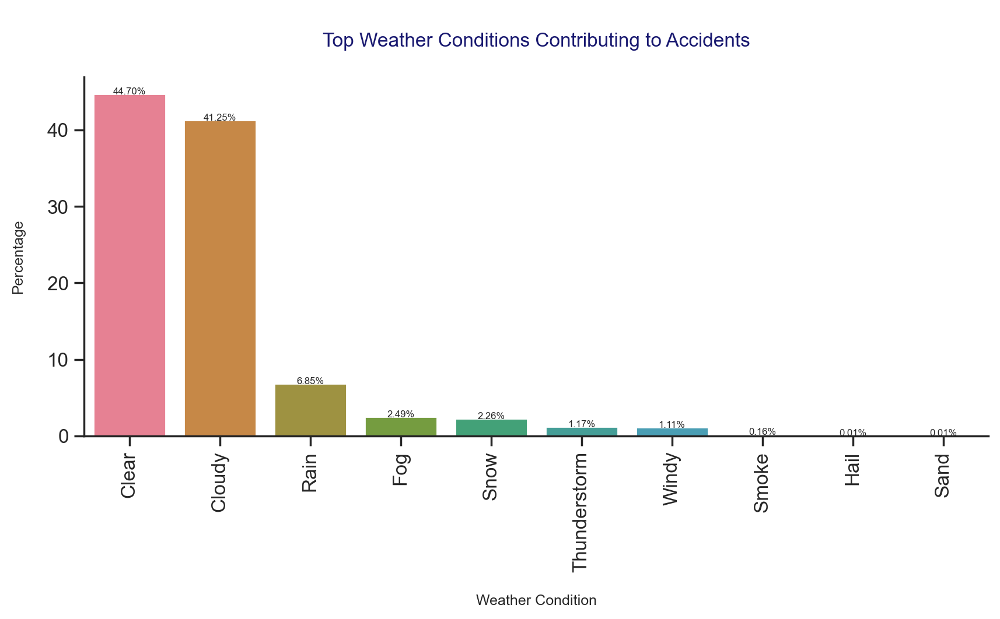

In [82]:
# Calculate percentages
total = wc['frequency'].sum()
wc['percentage'] = (wc['frequency'] / total) * 100

# Create a figure and axis
fig, ax = plt.subplots(figsize=(10, 4), dpi=200)  # Adjust the figure size for a vertical plot

# Plotting barplot with percentages
sns.barplot(x='weather_condition', y='percentage', data=wc, palette='husl')  # Remove orient parameter for vertical plot

# Add labels and title
ax.set_xlabel('\nWeather Condition', fontsize=9)
ax.set_ylabel('Percentage\n', fontsize=9)
ax.set_title('\nTop Weather Conditions Contributing to Accidents\n', fontsize=12, color='MidnightBlue')
plt.xticks(rotation=90)  # Adjust the rotation angle of x-axis labels

# Display percentages on the plot
for index, value in enumerate(wc['percentage']):
    plt.text(index, value, f'{value:.2f}%', fontsize=6, ha='center')

# Increase the font size of the axis tick labels
sns.set(rc={'xtick.labelsize': 8, 'ytick.labelsize': 8})

# Remove top and right spines
for i in ['top', 'right']:
    ax.spines[i].set_visible(False)

# Show the plot
plt.show()

### Is there any effect of temperature on accidents?

In [83]:
weather_cond=df["Temperature(F)"].value_counts()
weather_cond.sort_values(ascending=False).head(10)

Temperature(F)
77.0    11090
73.0    11076
68.0    10684
72.0    10217
75.0    10144
70.0    10075
63.0     9777
59.0     9650
64.0     9607
79.0     9480
Name: count, dtype: int64

<Axes: title={'center': ' Accident cases reported for different Temperatures'}, xlabel='No. of accidents', ylabel='Temperature(F)'>

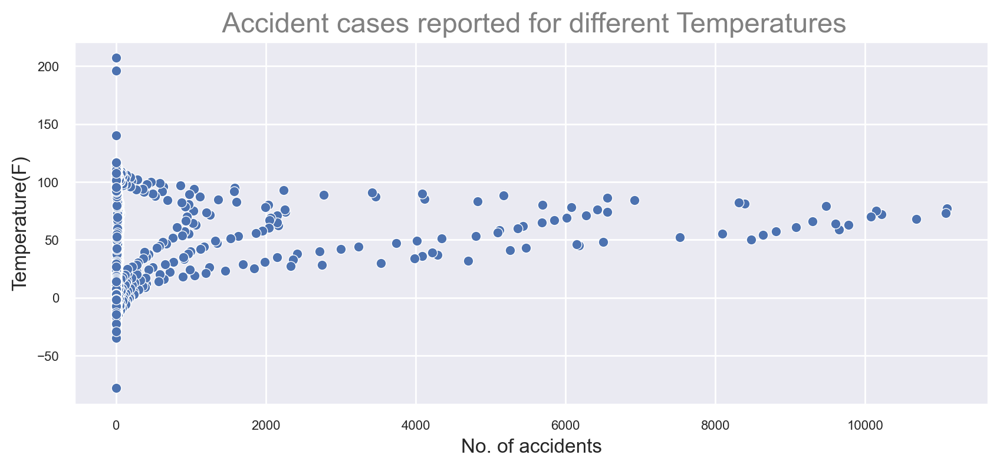

In [84]:
plt.figure(figsize=(10,4),dpi=200)
plt.title(" Accident cases reported for different Temperatures",size=17,color="grey")
plt.xlabel('No. of accidents')
plt.ylabel('Temperature(F)')
sns.scatterplot(y=weather_cond.index, x=weather_cond)

insight:

maximum no of cases occured between temperature range: 50-80 F.

### Is there any effect of Humidity on accidents?

In [85]:
humidity_effect=df["Humidity(%)"].value_counts()
humidity_effect.sort_values(ascending=False).head(10)

Humidity(%)
93.0     19064
100.0    18408
87.0     10969
90.0     10798
89.0      8979
96.0      8858
81.0      8304
84.0      8203
82.0      8115
86.0      7885
Name: count, dtype: int64

<Axes: title={'center': ' Accident cases reported for different humidity '}, xlabel='No. of accidents', ylabel='Humidity(%) '>

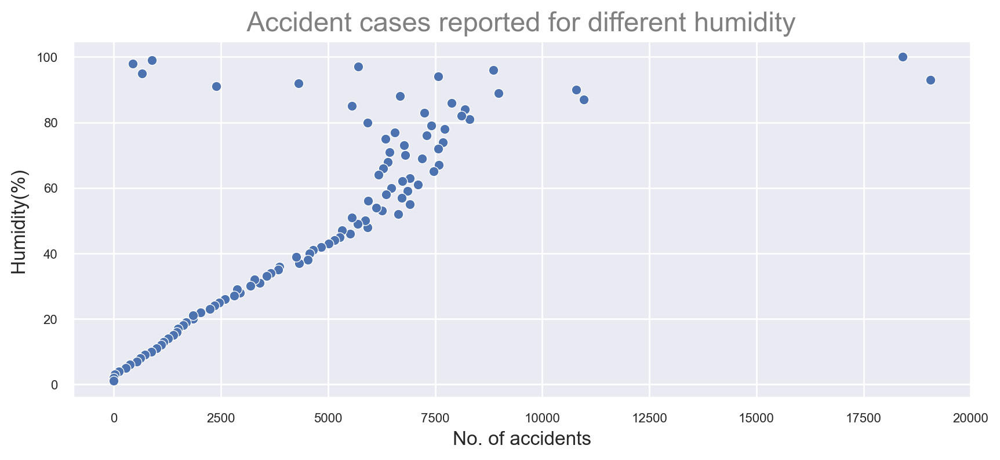

In [86]:
plt.figure(figsize=(10,4),dpi=200)
plt.title(" Accident cases reported for different humidity ",size=17,color="grey")
plt.xlabel('No. of accidents')
plt.ylabel('Humidity(%) ')
sns.scatterplot(y=humidity_effect.index, x=humidity_effect)

insight

maximum no of cases occured between humidity range: 80-100 %.
as the humidity increases the no of cases also increases.

## Analysis of Accidents in Miami City

Since, Miami tops the list where most number of accidents have taken place from 2016 to 2023. Let's explore the time series data of the accidents in this city and finally we will make a map visual of the city to see which streets are the most vulnerable to accidents in Miami.

In [87]:
# filter the dataframe to view data related to Miami only
miami = df[df['City'] == 'Miami']

year = miami['Year'].value_counts()
month = miami['Month'].value_counts().sort_index()

month_map = {1:'Jan' , 2:'Feb' , 3:'Mar' , 4:'Apr' , 5:'May' , 6:'Jun', 7:'Jul' , 8:'Aug', 9:'Sep',10:'Oct' , 11:'Nov' , 12:'Dec'}

hour = miami['Hour'].value_counts().sort_index()
hour_severity = miami[['Hour' , 'Severity']].groupby('Hour').agg({'Hour':'count', 'Severity' : 'mean'})

daily_accidents = miami['Weekday'].value_counts().sort_index()
day_map = {0:'Monday' , 1:'Tuesday' , 2:'Wednesday' , 3:"Thursday" , 4:'Friday' , 5:"Saturday" , 6:'Sunday'}
year_map = {x:x for x in year.index}
hour_map = {x:x for x in hour.index}

light_palette = sns.color_palette(palette='pastel')

Time Series Analysis of the Accidents in Miami City

Since we are going to draw time series plots, by year, month, weekday, and hour, it's better to visualize these charts in a single window for comprehensive view.

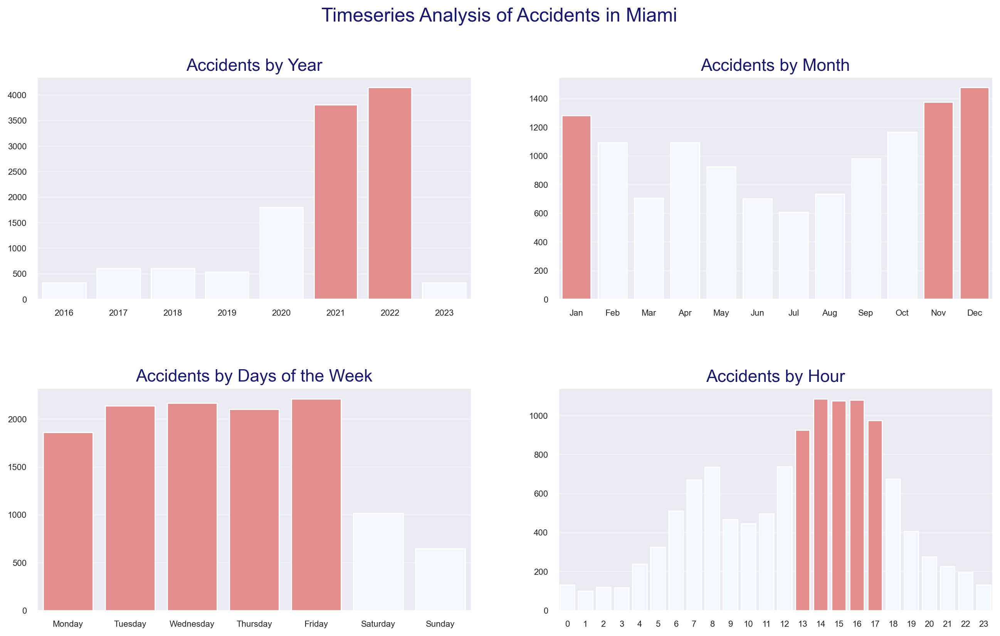

In [89]:
fig,([ax1,ax2],[ax3,ax4]) = plt.subplots(2,2,figsize=(16,9),dpi=200)

def plot_dist(kind, text, axis, LightCoral, skyblue):
    '''
    Reusable function to plot distribution based on input time criteria
    Usage : plot_dist(kind, text, axis, red , green) - all params mandatory
        kind : 'd' for day, 'm' for month , 'y' for year, 'h' for hour
        red  : list of item to be rendered red (max)
        skyblue : list of item to be rendered skyblue (min)
        text : Text to be shownn as part of the title
        axis : Axis to plot on
    '''
    if kind == 'd':
        tot, ser, map = 7, daily_accidents, day_map
    elif kind == 'm':
        tot, ser, map = 12, month ,  month_map
    elif kind == 'y':
        tot, ser, map = 8, year ,  year_map
    elif kind == 'h':
        tot, ser, map = 24, hour ,  hour_map
    
    day_color_map = ['AliceBlue' for _ in range(tot)]
    for l in LightCoral:
        day_color_map[l] = 'LightCoral' 
    for s in skyblue:
        day_color_map[s] = 'skyblue' 
    
    sns.barplot(x=ser.index.map(map) , y=ser, ax = axis, palette = day_color_map)
    axis.set_xlabel(None)
    axis.set_ylabel(None)
    axis.set_title(f'Accidents by {text}', fontdict = {'fontsize':16 , 'color':'MidnightBlue'})
    axis.grid(axis='y', linestyle='-', alpha=0.4) 
    
plt.subplots_adjust(wspace=0.2 , hspace = 0.4)
plt.suptitle("Timeseries Analysis of Accidents in Miami" , fontsize = 18 , color="MidnightBlue")

plot_dist('d' ,"Days of the Week", ax3,[0, 1, 2, 3, 4],[])
plot_dist('y' ,"Year", ax1,[5,6],[])
plot_dist('m' ,"Month", ax2, [0, 10, 11],[])
plot_dist('h' ,"Hour", ax4,LightCoral=[13,14,15,16,17],skyblue=[])
plt.show()


## What are the most accident-prone streets in Miami?

In [201]:
top_st = miami['Street'].value_counts().sort_values(ascending=False).head(10).index.tolist()
severity_top_st = miami[miami['Street'].isin(top_st)][['Street' , 'Severity']].groupby('Street').mean()
#severity_top_st = miami[miami['Street'].isin(top_st)][['Street' , 'Severity']].groupby('Street')['Severity'].apply(lambda x: x.mode().iloc[0])

# add a delay_time column to the miami df
diff = miami['End_Time'] - miami['Start_Time']
miami['DelayTime'] = round(diff.dt.seconds/3600,1)
top_st_delay = miami[miami['Street'].isin(top_st)][['Street' , 'DelayTime']] .groupby('Street').mean()

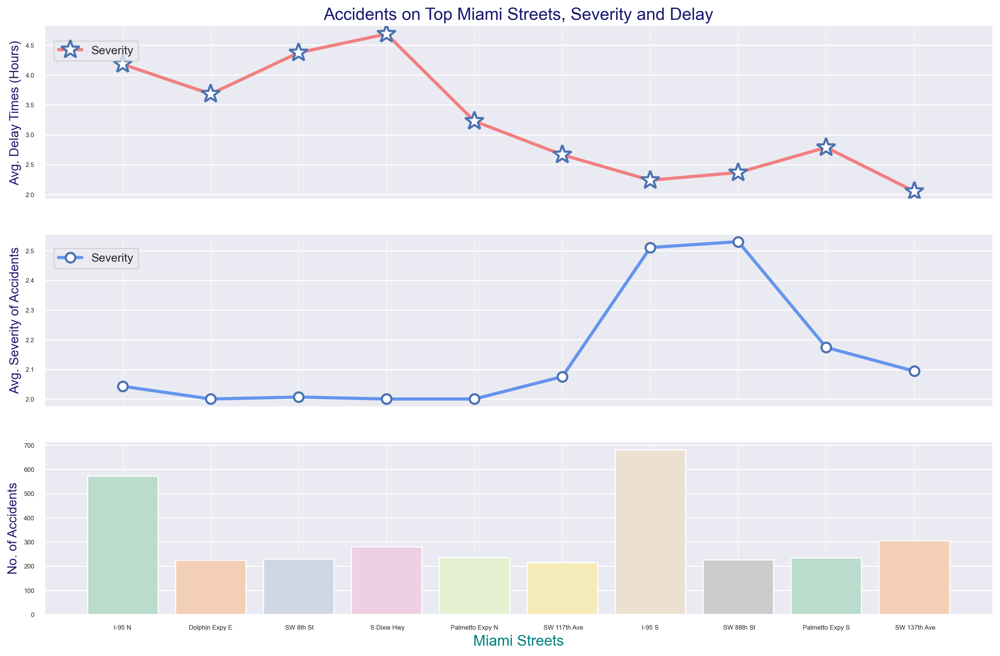

In [203]:
fig, (ax,ax1,ax2) = plt.subplots(3,1,figsize=(16,10),dpi=200, sharex=True)

# fig.subplots_adjust(hspace=0)
sns.countplot(data = miami[miami['Street'].isin(top_st)][['Street','Severity']], x='Street',ax=ax2, palette='Pastel2')

ax1.plot(severity_top_st, color='CornFlowerBlue', label='Severity',linewidth=3, linestyle='solid', marker='.',markersize=18, markerfacecolor='w',markeredgecolor='b',markeredgewidth='2')

ax.plot(top_st_delay, color='LightCoral', label='Severity',linewidth=3,linestyle='solid',marker='*', markersize=18,markerfacecolor='w',markeredgecolor='b',markeredgewidth='2')

ax.spines[('top')].set_visible(False)
ax.spines[('right')].set_visible(False)
ax1.spines[('right')].set_visible(False)
ax2.spines[('right')].set_visible(False)
ax2.set_xlabel("Miami Streets", fontdict = {'fontsize':14 , 'color':'Teal'} )
ax2.set_ylabel("No. of Accidents", fontdict = {'fontsize':12 , 'color':'MidnightBlue'})
ax1.set_ylabel("Avg. Severity of Accidents", fontdict = {'fontsize':12 , 'color':'MidnightBlue'})
ax.set_ylabel("Avg. Delay Times (Hours)", fontdict = {'fontsize':12 , 'color':'MidnightBlue'})
ax.set_title('Accidents on Top Miami Streets, Severity and Delay', fontdict = {'fontsize':16 , 'color':'MidnightBlue'})

ax1.legend(loc=(0.01,0.8))
ax.legend(loc=(0.01,0.8))
ax.grid(axis='x', linestyle='-', alpha=0.4)
ax1.grid(axis='x', linestyle='-', alpha=0.4)
ax2.grid(axis='x', linestyle='-', alpha=0.4)
plt.show()

In [204]:
import plotly.graph_objects as go
from plotly.offline import init_notebook_mode,iplot,plot
init_notebook_mode(connected=True)

In [205]:
fig = px.density_mapbox(miami, lat='Start_Lat', lon='Start_Lng', z='Severity', hover_name='Street', radius=5,
                        center=dict(lat=miami['Start_Lat'].median(), lon=miami['Start_Lng'].median()), zoom=12,
                        mapbox_style="open-street-map", height=900)

fig.show()

## Machine Learning Task

In [206]:
import pandas as pd
df = pd.read_csv("USA.csv")

### Data Cleaning

In [207]:
df.duplicated().sum()

0

In [208]:
df.isnull().sum()

ID                            0
Source                        0
Severity                      0
Start_Time                    0
End_Time                      0
Start_Lat                     0
Start_Lng                     0
End_Lat                  220377
End_Lng                  220377
Distance(mi)                  0
Description                   1
Street                      691
City                         19
County                        0
State                         0
Zipcode                     116
Country                       0
Timezone                    507
Airport_Code               1446
Weather_Timestamp          7674
Temperature(F)            10466
Wind_Chill(F)            129017
Humidity(%)               11130
Pressure(in)               8928
Visibility(mi)            11291
Wind_Direction            11197
Wind_Speed(mph)           36987
Precipitation(in)        142616
Weather_Condition         11101
Amenity                       0
Bump                          0
Crossing

In [209]:
threshold = 25

# Calculate the percentage of missing values for each column
missing_percentage = (df.isnull().mean() * 100)

# Filter columns with missing values exceeding the threshold
columns_with_missing_values = missing_percentage[missing_percentage > threshold].index

print("Columns with more than 25% missing values:")
print(columns_with_missing_values)

Columns with more than 25% missing values:
Index(['End_Lat', 'End_Lng', 'Wind_Chill(F)', 'Precipitation(in)'], dtype='object')


In [210]:
cat_features = [ 'Country', 'Timezone', 'Amenity', 'Bump', 'Crossing', 
             'Give_Way', 'Junction', 'No_Exit', 'Railway', 'Roundabout', 'Station', 
             'Stop', 'Traffic_Calming', 'Traffic_Signal', 'Turning_Loop', 'Sunrise_Sunset', 
             'Civil_Twilight', 'Nautical_Twilight', 'Astronomical_Twilight']
print("Unique values of categorical features:")
for i in cat_features:
  print(i,df[i].unique().size)

Unique values of categorical features:
Country 1
Timezone 5
Amenity 2
Bump 2
Crossing 2
Give_Way 2
Junction 2
No_Exit 2
Railway 2
Roundabout 2
Station 2
Stop 2
Traffic_Calming 2
Traffic_Signal 2
Turning_Loop 1
Sunrise_Sunset 3
Civil_Twilight 3
Nautical_Twilight 3
Astronomical_Twilight 3


Features 'ID' doesn't provide any useful information about accidents themselves. 'TMC', 'Distance(mi)', 'End_Time' (we have start time), 'Duration', 'End_Lat', and 'End_Lng'(we have start location) can be collected only after the accident has already happened and hence cannot be predictors for serious accident prediction. For 'Description', the POI features have already been extracted from it by dataset creators. Let's get rid of these features first.

In [211]:
df = df.drop(['ID','Description', 'End_Time', 
              'End_Lat', 'End_Lng', 'Country', 'Turning_Loop'], axis=1)

In [212]:
df.isnull().sum()


Source                        0
Severity                      0
Start_Time                    0
Start_Lat                     0
Start_Lng                     0
Distance(mi)                  0
Street                      691
City                         19
County                        0
State                         0
Zipcode                     116
Timezone                    507
Airport_Code               1446
Weather_Timestamp          7674
Temperature(F)            10466
Wind_Chill(F)            129017
Humidity(%)               11130
Pressure(in)               8928
Visibility(mi)            11291
Wind_Direction            11197
Wind_Speed(mph)           36987
Precipitation(in)        142616
Weather_Condition         11101
Amenity                       0
Bump                          0
Crossing                      0
Give_Way                      0
Junction                      0
No_Exit                       0
Railway                       0
Roundabout                    0
Station 

### Dealing with Missing 

In [213]:
# Specify the numeric columns for interpolation
numeric_columns = ['Temperature(F)', 'Wind_Chill(F)', 'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Speed(mph)', 'Precipitation(in)']

df_sorted = df.sort_values(by='Start_Time')

# Fill missing values in 'Weather_Timestamp' using forward-fill
df_sorted['Weather_Timestamp'].fillna(method='ffill', inplace=True)

# Apply linear interpolation to fill missing values in numeric columns
df_sorted[numeric_columns] = df_sorted[numeric_columns].interpolate(method='linear')

# If needed, you can sort the DataFrame back to its original order
df_interpolated = df_sorted.sort_index()
# Check the DataFrame for remaining missing values
#print(df_interpolated.isnull().sum())

In [214]:
# For categoricals columns, Impute missing values with mode imputation
for col in df_interpolated.columns:
    if df_interpolated[col].dtype == 'object':
        df_interpolated[col].fillna(df_interpolated[col].mode().iloc[0], inplace=True)

In [215]:
print(df_interpolated.isnull().sum())

Source                   0
Severity                 0
Start_Time               0
Start_Lat                0
Start_Lng                0
Distance(mi)             0
Street                   0
City                     0
County                   0
State                    0
Zipcode                  0
Timezone                 0
Airport_Code             0
Weather_Timestamp        0
Temperature(F)           0
Wind_Chill(F)            0
Humidity(%)              0
Pressure(in)             0
Visibility(mi)           0
Wind_Direction           0
Wind_Speed(mph)          0
Precipitation(in)        0
Weather_Condition        0
Amenity                  0
Bump                     0
Crossing                 0
Give_Way                 0
Junction                 0
No_Exit                  0
Railway                  0
Roundabout               0
Station                  0
Stop                     0
Traffic_Calming          0
Traffic_Signal           0
Sunrise_Sunset           0
Civil_Twilight           0
N

In [216]:
df = df_interpolated.copy()

### Encoding

In [217]:
categorical_columns = df.select_dtypes(include=['object','bool']).columns

In [218]:
from sklearn import preprocessing
from sklearn.preprocessing import LabelEncoder

for i in categorical_columns:
    en = preprocessing.LabelEncoder()
    df[i]= en.fit_transform(df[i])

In [219]:
df.head()

,Source,Severity,Start_Time,Start_Lat,Start_Lng,Distance(mi),Street,City,County,State,Zipcode,Timezone,Airport_Code,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,1,2,155411,30.641211,-91.153481,0.000,55978,9464,446,16,81546,0,296,92906,77.0,77.0,62.0,29.92,10.0,10,5.0,0.0,11,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
1,0,2,461396,38.990562,-77.399070,0.056,10884,8128,841,43,18653,1,899,242976,45.0,43.0,48.0,29.91,10.0,20,5.0,0.0,11,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1
2,0,2,434779,34.661189,-120.492822,0.022,52513,4759,1266,3,111576,3,1060,230808,68.0,68.0,73.0,29.79,10.0,20,13.0,0.0,11,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
3,0,2,378629,43.680592,-92.993317,1.054,37322,341,975,21,73969,0,187,206120,27.0,15.0,86.0,28.49,10.0,3,15.0,0.0,106,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,2,255307,35.395484,-118.985176,0.046,25344,387,749,3,111019,3,236,147656,42.0,42.0,34.0,29.77,10.0,0,0.0,0.0,11,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1


### AlutoGluon 

In [220]:
import pandas as pd
from autogluon.tabular import TabularDataset, TabularPredictor
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Split the data into training and testing sets
train_data, test_data = train_test_split(df, test_size=0.2, random_state=42)

# Define the task as 'classification' since it's a classification problem
predictor = TabularPredictor(label='Severity', path='ag_models').fit(train_data)

# Extract features from the test data (without labels)
X_test = test_data.drop('Severity', axis=1)

# Make predictions on the test set
y_pred = predictor.predict(X_test)

# Evaluate the accuracy of the predictions
accuracy = accuracy_score(test_data['Severity'], y_pred)
accuracy

No presets specified! To achieve strong results with AutoGluon, it is recommended to use the available presets.
	Recommended Presets (For more details refer to https://auto.gluon.ai/stable/tutorials/tabular/tabular-essentials.html#presets):
	presets='best_quality'   : Maximize accuracy. Default time_limit=3600.
	presets='high_quality'   : Strong accuracy with fast inference speed. Default time_limit=3600.
	presets='good_quality'   : Good accuracy with very fast inference speed. Default time_limit=3600.
	presets='medium_quality' : Fast training time, ideal for initial prototyping.
	Consider setting `time_limit` to ensure training finishes within an expected duration or experiment with a small portion of `train_data` to identify an ideal `presets` and `hyperparameters` configuration.
Beginning AutoGluon training ...
AutoGluon will save models to "ag_models"
=================== System Info ===================
AutoGluon Version:  1.0.0
Python Version:     3.11.5
Operating System:   Darwin


[1000]	valid_set's multi_error: 0.104


	0.8968	 = Validation score   (accuracy)
	65.23s	 = Training   runtime
	0.23s	 = Validation runtime
Fitting model: LightGBM ...


[1000]	valid_set's multi_error: 0.10175
[2000]	valid_set's multi_error: 0.098


	0.9022	 = Validation score   (accuracy)
	135.33s	 = Training   runtime
	0.51s	 = Validation runtime
Fitting model: RandomForestGini ...
	To force training the model, specify the model hyperparameter "ag.max_memory_usage_ratio" to a larger value (currently 1.0, set to >=1.41 to avoid the error)
		To set the same value for all models, do the following when calling predictor.fit: `predictor.fit(..., ag_args_fit={"ag.max_memory_usage_ratio": VALUE})`
		Setting "ag.max_memory_usage_ratio" to values above 1 may result in out-of-memory errors. You may consider using a machine with more memory as a safer alternative.
	Not enough memory to train RandomForestGini... Skipping this model.
Fitting model: RandomForestEntr ...
	To force training the model, specify the model hyperparameter "ag.max_memory_usage_ratio" to a larger value (currently 1.0, set to >=1.34 to avoid the error)
		To set the same value for all models, do the following when calling predictor.fit: `predictor.fit(..., ag_args_fit={

0.89619

In [225]:
from sklearn.metrics import mean_squared_error
import numpy as np
# Calculate RMSE
rmse = np.sqrt(mean_squared_error(test_data['Severity'], y_pred))

print("Accuracy:", accuracy)
print("RMSE:", rmse)

Accuracy: 0.89619
RMSE: 0.4061280586219081


In [226]:
predictor.leaderboard()

,model,score_val,eval_metric,pred_time_val,fit_time,pred_time_val_marginal,fit_time_marginal,stack_level,can_infer,fit_order
0,LightGBM,0.90225,accuracy,0.508865,135.330082,0.508865,135.330082,1,True,5
1,WeightedEnsemble_L2,0.90225,accuracy,0.509488,135.853376,0.000623,0.523294,2,True,10
2,XGBoost,0.89900,accuracy,0.101794,68.945630,0.101794,68.945630,1,True,7
3,CatBoost,0.89800,accuracy,0.019680,404.621200,0.019680,404.621200,1,True,6
4,LightGBMLarge,0.89750,accuracy,0.061251,29.303164,0.061251,29.303164,1,True,9
5,LightGBMXT,0.89675,accuracy,0.225055,65.225330,0.225055,65.225330,1,True,4
6,NeuralNetTorch,0.88875,accuracy,0.029124,246.891600,0.029124,246.891600,1,True,8
7,NeuralNetFastAI,0.88750,accuracy,0.036437,168.336277,0.036437,168.336277,1,True,3
8,KNeighborsUnif,0.81625,accuracy,1.327785,1.725663,1.327785,1.725663,1,True,1
9,KNeighborsDist,0.81075,accuracy,1.145585,0.179315,1.145585,0.179315,1,True,2


In [223]:
import matplotlib.pyplot as plt

# Get feature importance
feature_importance = predictor.feature_importance(test_data)

# Display the top 30 features in a horizontal bar chart
top_features = feature_importance.sort_values(by='importance', ascending=False).head(20)
top_features

These features in provided data are not utilized by the predictor and will be ignored: ['Roundabout']
Computing feature importance via permutation shuffling for 37 features using 5000 rows with 5 shuffle sets...
	154.61s	= Expected runtime (30.92s per shuffle set)
	151.89s	= Actual runtime (Completed 5 of 5 shuffle sets)


,importance,stddev,p_value,n,p99_high,p99_low
Source,0.10576,0.006546,1.752030e-06,5,0.119238,0.092282
Street,0.07588,0.002189,8.302785e-08,5,0.080387,0.071373
Start_Time,0.05888,0.004929,5.837004e-06,5,0.069028,0.048732
Start_Lat,0.01708,0.002028,2.340010e-05,5,0.021255,0.012905
Start_Lng,0.01604,0.002692,9.176157e-05,5,0.021583,0.010497
Zipcode,0.01240,0.002289,1.332529e-04,5,0.017113,0.007687
Distance(mi),0.01148,0.002823,4.057966e-04,5,0.017294,0.005666
Weather_Timestamp,0.01096,0.001785,8.161345e-05,5,0.014636,0.007284
State,0.00684,0.002393,1.538851e-03,5,0.011768,0.001912
County,0.00516,0.001493,7.541317e-04,5,0.008233,0.002087


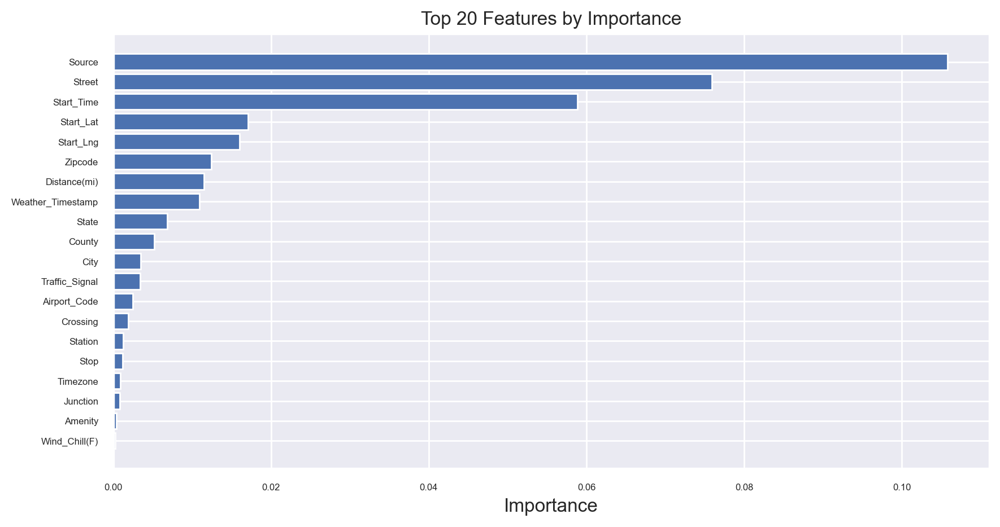

In [230]:
plt.figure(figsize=(10, 5), dpi=200)
plt.barh(top_features.index[::-1], top_features['importance'][::-1])
plt.xlabel('Importance')
plt.title('Top 20 Features by Importance')
plt.show()